In [2]:
# !pip install pymongo plotly
from pymongo import MongoClient
# pprint library is used to make the output look more pretty
from pprint import pprint

def connect_mongodb(url,database):
    connection = MongoClient(url)
    return connection[database]

mongo_host_url = "mongodb://localhost:27017/tryone"
db = connect_mongodb(mongo_host_url, "tryone")

     |████████████████████████████████| 518 kB 251 kB/s eta 0:00:01


In [20]:
import pandas as pd
pd.options.plotting.backend = "plotly"

def read_mongo_to_df(db,collection,biosignal):
    data = db[collection].find_one({'name': biosignal})
    df = pd.DataFrame(data["values"], columns=[biosignal])
    return data["values"]

patient = "test3" #Thu Jun 03 2021 21:42:50 GMT+0530 (India Standard Time) to Thu Jun 03 2021 21:51:06 
biosignals = {}
signals = ['PData', 'SData', 'TData', 'BData', 'EData', 'PCData', 'SCData', 'TCData', 'BCData', 'WData', 'WCData', 'YData', 'YCData']
for signal in signals:
    biosignals[signal] = read_mongo_to_df(db,patient,signal)

biosignal_df = pd.DataFrame.from_dict(dict([ (k,pd.Series(v)) for k,v in biosignals.items()]))
biosignal_df.head()
# biosignals["pat"] = read_mongo_to_df(db,patient,"PData")
# biosignals["red"] = read_mongo_to_df(db,patient,"BData")
# biosignals["ir"] = read_mongo_to_df(db,patient,"SData")
# biosignals["real_imp"] = read_mongo_to_df(db,patient,"WCData")
# biosignals["img_imp"] = read_mongo_to_df(db,patient,"WData")
# biosignals["temp"] = read_mongo_to_df(db,patient,"TData")
# biosignals["env"] = read_mongo_to_df(db,patient,"EData")
# biosignals

,PData,SData,TData,BData,EData,PCData,SCData,TCData,BCData,WData,WCData,YData,YCData
0,10409.0,32720.0,2892.0,20800.0,2885.0,10688,5368.0,2910.0,384,65377.0,202.0,3231.0,48051.0
1,10375.0,32736.0,2894.0,20784.0,2883.0,10656,5368.0,2911.0,392,65373.0,211.0,3240.0,48064.0
2,10362.0,32688.0,2890.0,20792.0,2882.0,10592,5352.0,2913.0,400,65376.0,203.0,3223.0,48040.0
3,10367.0,32680.0,2891.0,20792.0,2882.0,10544,5368.0,2911.0,400,65373.0,211.0,3227.0,48037.0
4,10372.0,32672.0,2891.0,20800.0,2883.0,10560,5344.0,2911.0,392,65377.0,202.0,3212.0,48028.0


In [21]:
combined_data = pd.DataFrame.from_dict(dict([ (k,pd.Series(v)) for k,v in biosignals.items()]))
# combined_data.to_csv('age52June132021_singleHand.csv',index=False)
combined_data.to_csv('breathing.csv',index=False)
# ppg_data.plot()
# combined_data = pd.concat([pat_data, ppg_red_data, ppg_ir_data,bioimp_real_data,bioimp_img_data], sort=False)
combined_data.head()

,PData,SData,TData,BData,EData,PCData,SCData,TCData,BCData,WData,WCData,YData,YCData
0,10409.0,32720.0,2892.0,20800.0,2885.0,10688,5368.0,2910.0,384,65377.0,202.0,3231.0,48051.0
1,10375.0,32736.0,2894.0,20784.0,2883.0,10656,5368.0,2911.0,392,65373.0,211.0,3240.0,48064.0
2,10362.0,32688.0,2890.0,20792.0,2882.0,10592,5352.0,2913.0,400,65376.0,203.0,3223.0,48040.0
3,10367.0,32680.0,2891.0,20792.0,2882.0,10544,5368.0,2911.0,400,65373.0,211.0,3227.0,48037.0
4,10372.0,32672.0,2891.0,20800.0,2883.0,10560,5344.0,2911.0,392,65377.0,202.0,3212.0,48028.0


In [6]:
from scipy import signal
biosignal_df.plot(y=["SData","SCData"])
signalc = biosignal_df["SCData"].dropna()
fs = 88
fc = 30  # Cut-off frequency of the filter
wc = fc / (fs / 2) # Normalize the frequency
b, a = signal.butter(6, wc, 'low') #https://morf.lv/files//max30100.pdf
output = signal.filtfilt(b, a, signalc)


In [8]:
biosignal_df["FiltSCData"]=pd.DataFrame(output) 
biosignal_df.plot(y=["SCData","FiltSCData"])

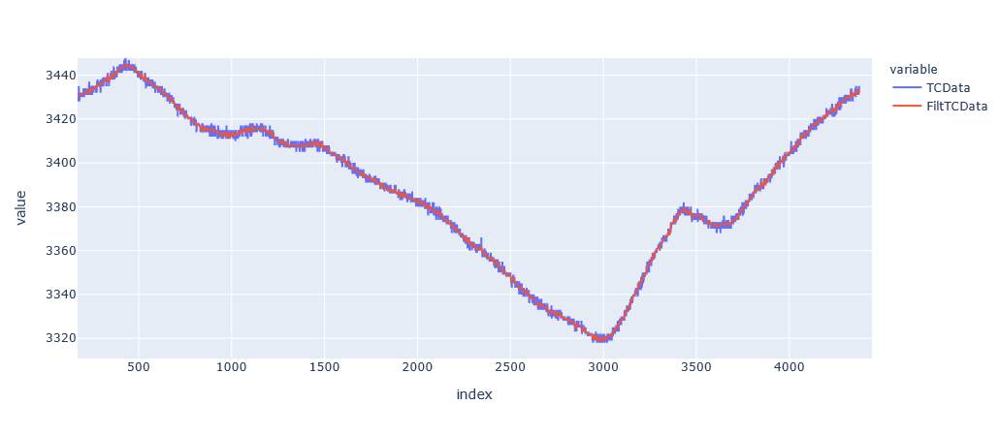

In [15]:
signalc = biosignal_df["TCData"].dropna()
fs = 8.8
fc = 1  # Cut-off frequency of the filter
wc = fc / (fs / 2) # Normalize the frequency
b, a = signal.butter(5, wc, 'low') #https://morf.lv/files//max30100.pdf
output = signal.filtfilt(b, a, signalc)
biosignal_df["FiltTCData"]=pd.DataFrame(output) 
biosignal_df.plot(y=["TCData","FiltTCData"])

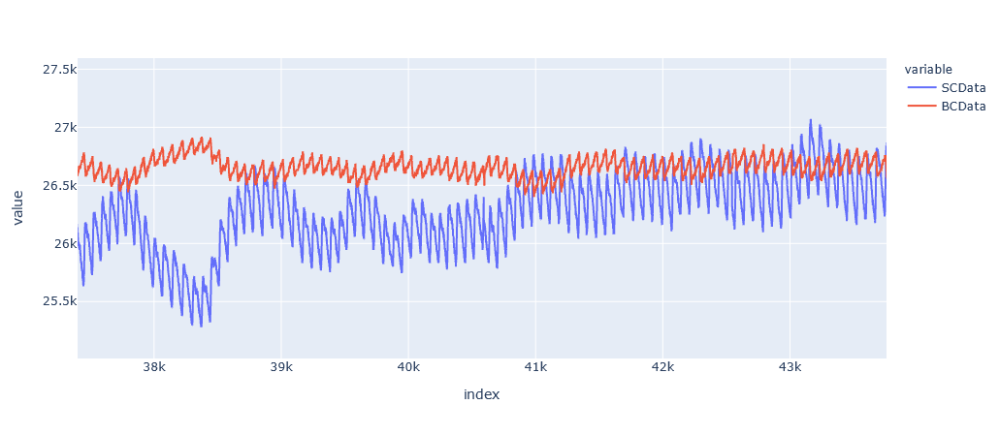

In [23]:
biosignal_df.plot(y=["SCData","BCData"])

In [5]:
signalc = biosignal_df["PCData"].dropna()
fs = 88
fc = 20  # Cut-off frequency of the filter
wc = fc / (fs / 2) # Normalize the frequency
b, a = signal.butter(5, wc, 'low') #https://morf.lv/files//max30100.pdf
output = signal.filtfilt(b, a, signalc)
biosignal_df["FiltPCData"]=pd.DataFrame(output) 
biosignal_df.plot(y=["PCData","FiltPCData"])

AttributeError: 'str' object has no attribute 'butter'

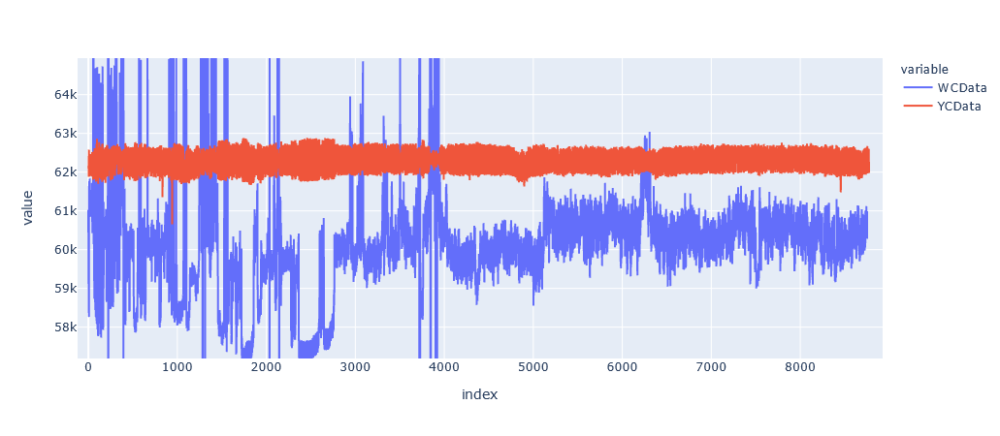

In [22]:
biosignal_df.plot(y=["WCData","YCData"])

In [3]:
data = open('test5.txt','r').read().split("X")
decode ={ "P":"PAT", "p":"pat", "R":"RED","r":"red","I":"IR","i":"ir","T":"TEMP","t":"temp","E":"env","B":"real_imp","b":"img_imp","A":"REAL_IMP","a":"IMG_IMP"}
# biosignals ={x:[] for x in decode.values()}
# print(biosignals)
# for line in data:
#     try:
#         biosignals[decode[line[0]]].append(int(line[1:]))
#     except:
#         print(line)

# # 

In [20]:
decode["T"]

'TEMP'

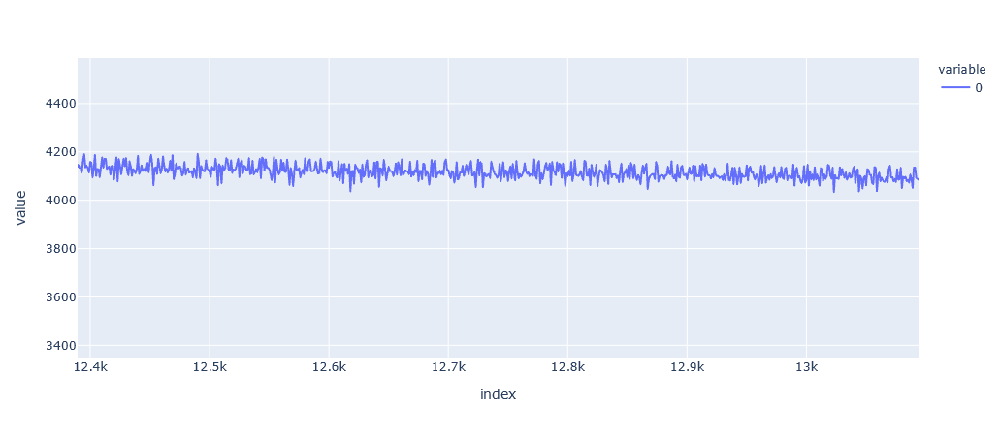

In [18]:
bioimp_real_data = read_mongo_to_df(db,patient,"WData")
bioimp_img_data = read_mongo_to_df(db,patient,"WCData")
bioimp_real_data.plot()

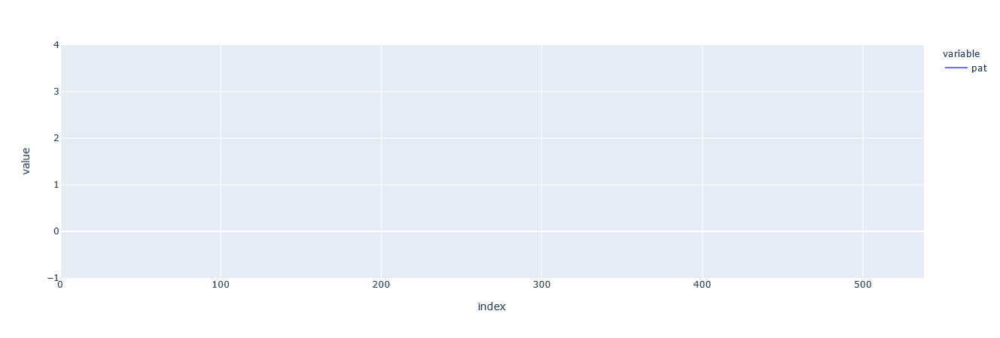

In [5]:
combined_data["pat"].plot()

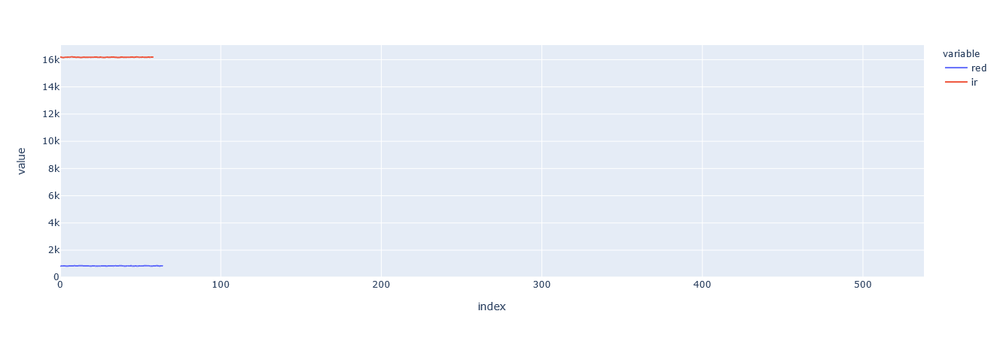

In [6]:
combined_data.plot(y=["red","ir"])

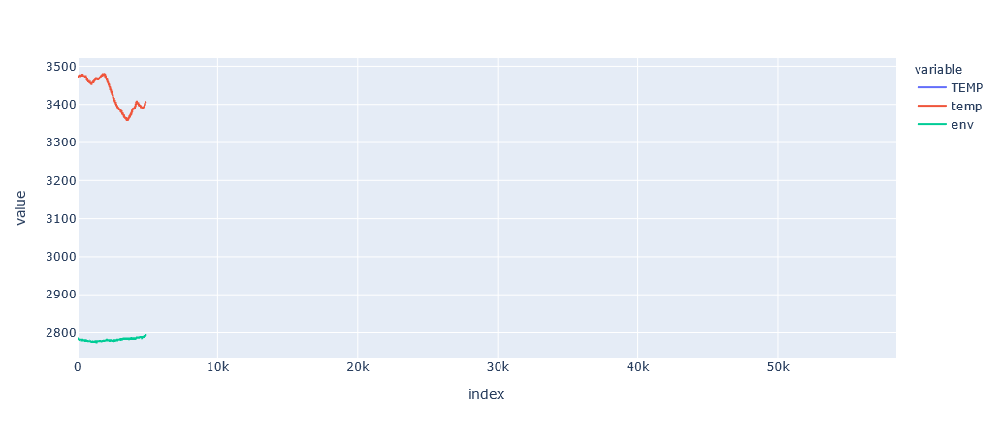

In [18]:
combined_data.plot(y=["TEMP","temp","env"])

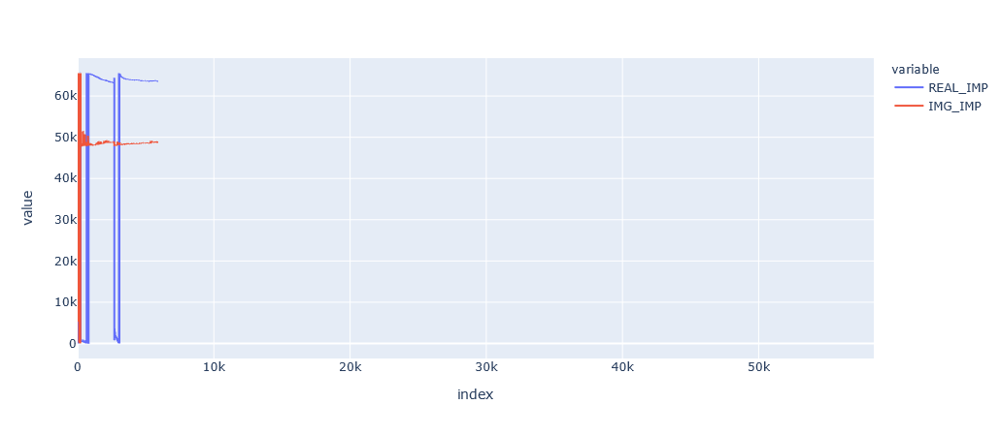

In [25]:
combined_data.plot(y = ["REAL_IMP", "IMG_IMP"])

In [31]:
data2 = open('test2.txt','r').read().split("X")
ppg_data = []
for line in data2:
    if (line[0] == "r"):
        ppg_data.append(int(line[1:]))
ppg = pd.DataFrame(ppg_data)

ValueError: invalid literal for int() with base 10: 'or - AD5933 not found\n\nr25835'